In [ ]:
"""BERTopic with Korean text
https://wikidocs.net/162079

"""

In [6]:
import os
import re
import numpy as np
import pandas as pd
from pathlib import Path
from nltk import tokenize
import matplotlib as mpl
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from datetime import datetime
from textwrap import dedent
import pickle
from nltk import sent_tokenize

from sentence_transformers import SentenceTransformer
from bertopic import BERTopic
import umap.plot
from umap import UMAP
from hdbscan import HDBSCAN
# from mecab import MeCab
from konlpy.tag import Mecab
from sklearn.feature_extraction.text import CountVectorizer
from bertopic.vectorizers import ClassTfidfTransformer
# from bertopic.representation import KeyBERTInspired
from bertopic.representation import MaximalMarginalRelevance

# from youtube_helper import YouTubeHelper

In [31]:
import os
os.environ["TOKENIZERS_PARALLELISM"] = "true"
pd.set_option('display.max_colwidth', None)

In [32]:
DATA_DIR = Path.cwd() / 'content'
MODEL_DIR = Path.cwd() / 'models'

In [74]:
videos = pd.read_csv(DATA_DIR / 'video_details_full.csv')
videos.published_at = pd.to_datetime(videos.published_at)
videos.window_start = pd.to_datetime(videos.window_start)
videos.window_end = pd.to_datetime(videos.window_end)

In [76]:

def get_nuclear_videos(videos, keywords_list, title_keywords=None):
    ids = set()
    for keywords in keywords_list:
        # all keywords should be in the title or description
        ids.update(videos[videos.video_title.apply(lambda x: all(word in x for word in keywords))].video_id.tolist())
        ids.update(videos[videos.video_description.apply(lambda x: all(word in str(x) for word in keywords))].video_id.tolist())
    if title_keywords is not None:
        for keywords in title_keywords:
            ids.update(videos[videos.video_title.apply(lambda x: all(word in x for word in keywords))].video_id.tolist())
    return videos[videos.video_id.isin(ids)]

korea_names = ['한국', '남한', '대한민국'] # '한반도'
korean_polititians = ['윤석열', '윤 대통령', '박정희', '박근혜', '박 대통령', '김기현', '문재인', '문 대통령']
base = korea_names + korean_polititians

nuclear_videos = get_nuclear_videos(
    videos,
    keywords_list= \
        # [[x] + ['핵', '무장'] for x in base] + # armament
        # [[x] + ['핵', '개발'] for x in base] + # development
        # [[x] + ['핵', '무기'] for x in base] + # weapons
        # [[x] + ['핵', '보유'] for x in base] + # possession
        # [[x] + ['핵', '확산'] for x in base] + # proliferation
        # [[x] + ['핵', '완성'] for x in base] + # completion
        # [[x] + ['핵', '탈퇴'] for x in base] + # withdrawal
        # [[x] + ['핵', '우산'] for x in base] + # umbrella
        # [[x] + ['한미상호방위조약'] for x in base] # mutual defense treaty
        
        [
            ['핵', '무장'], # armament
            ['핵', '개발'], # development
            
            # uncomment to include all keywords (350)
            # ['핵', '무기'], # weapons
            # ['핵', '보유'], # possession
            # ['핵', '확산'], # proliferation
            # ['핵', '완성'], # completion
            # ['핵', '탈퇴'], # withdrawal
            # ['핵', '우산'], # umbrella
            # ['NPT'], # NPT
            # ['한미상호방위조약'] # mutual defense treaty
        ]
)

print(len(nuclear_videos))

1551


In [182]:
# nuclear_videos.to_csv(DATA_DIR / 'nuclear_videos.csv', index=False)

In [137]:
# videos.iloc[videos[~videos.video_id.isin(nuclear_videos.video_id.tolist())].video_title.str.contains('햑').index].tail(60)

In [393]:
# videos[videos.video_description.apply(lambda x: all(word in str(x) for word in ['한국', '핵', '포기']))]

In [376]:
# videos.iloc[2873].video_description

In [71]:
def clean_text(text):
    clean_text = str(text)
    clean_text = re.sub(r"[ㅋㅎㅠㅜㅡ~;^@\-\n\s]+", ' ', clean_text)
    clean_text = re.sub(r"[-=+,#/\?:“”^$*\"※~&%ㆍ☞!』\\‘|\(\)\[\]\<\>`\'…》]", '.', clean_text)
    clean_text = re.sub(r"[\.]+", '.', clean_text)
    clean_text = re.sub(r"[!]+", '!', clean_text)
    clean_text = re.sub(r"[?]+", '?', clean_text)
    
    # remove urls
    clean_text = re.sub(r"http\S+", ' ', clean_text)
    
    # remove multiple spaces
    clean_text = re.sub(r"\s+", ' ', clean_text)
    
    return clean_text#.strip()

In [48]:
# yt = YouTubeHelper()
# comments_df = yt.load_comments(comments_dir=COMMENTS_DIR)

comments_df = pd.read_csv(DATA_DIR / 'comments_full.csv')
comments_df.published_at = pd.to_datetime(comments_df.published_at)
comments_df.updated_at = pd.to_datetime(comments_df.updated_at)
comments_df = comments_df.drop(columns=['author_profile_image_url', 'author_channel_url', 'etag'])
print(len(comments_df))

537535


In [72]:
# Clean comments
comments_df['comment_clean'] = comments_df['comment_text'].apply(clean_text)

# Remove short comments (less than 5 characters)
comments_df = comments_df[comments_df['comment_clean'].str.len() > 9]
# comments_df = comments_df[comments_df.is_top_level_comment == True]
print(len(comments_df))

490813


In [10]:
comments_df.head(1)

,published_at,updated_at,video_id,comment_id,parent_id,is_top_level_comment,comment_text,author_display_name,author_channel_id,like_count,comment_clean
0,2022-03-11 15:16:58+00:00,2022-03-11 15:16:58+00:00,aUrdB_Awn3w,UgwoEwbD29y57EbuTut4AaABAg,NaN,True,독자개발아니면핵고유 핵우산은 소 용헚 없음,주나라,UCctlWJYESr_1n6uN5iKOvKw,0,독자개발아니면핵고유 핵우산은 소 용헚 없음


In [77]:
# nuclear comments which only includes comments from videos in nuclear_videos
nuclear_comments = comments_df[comments_df.video_id.isin(nuclear_videos.video_id)]
print(f"Number of total comments: {len(nuclear_comments):,}")
print(f"Number of top-level comments: {len(nuclear_comments[nuclear_comments.is_top_level_comment == True]):,}")
print(f"Number of reply comments: {len(nuclear_comments[nuclear_comments.is_top_level_comment == False]):,}")

Number of total comments: 168,356
Number of top-level comments: 138,721
Number of reply comments: 29,635


In [181]:
# nuclear_comments.to_csv(DATA_DIR / 'nuclear_comments.csv', index=False)

In [44]:
nuclear_comments = pd.read_csv(DATA_DIR / 'nuclear_comments.csv')

In [78]:
docs = nuclear_comments['comment_clean'].tolist()

### Number of comments per month (nuclear related videos)

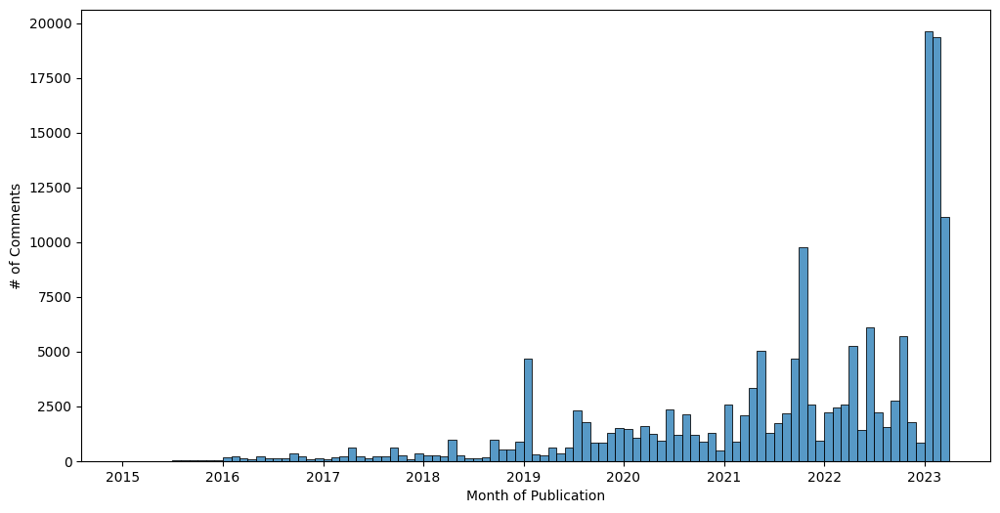

In [225]:

fig, ax = plt.subplots(figsize=(12, 6))
bins = pd.date_range(start='2015-01-01', end='2023-04-01', freq='1MS')
sns.histplot(nuclear_comments, x='published_at', bins=mpl.dates.date2num(bins))
# ax.set_title('Number of Comments per Month')
ax.set_xlabel('Month of Publication') 
ax.set_ylabel('# of Comments')
plt.show()

### Number of videos per month (nuclear related videos)

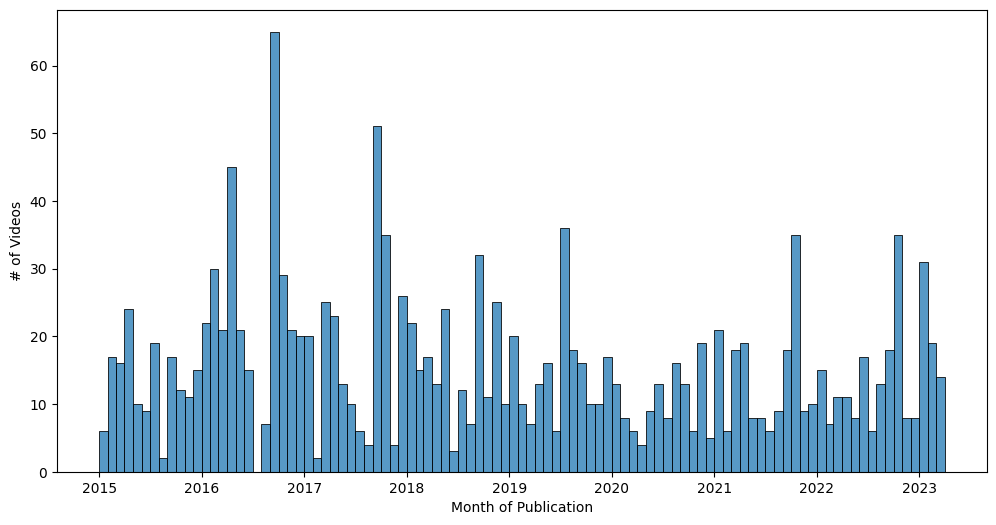

In [224]:
# plot the numner of nuclear videos per month
fig, ax = plt.subplots(figsize=(12, 6))
bins = pd.date_range(start='2015-01-01', end='2023-04-01', freq='1MS')
sns.histplot(nuclear_videos, x='published_at', bins=mpl.dates.date2num(bins))
# ax.set_title('Number of Videos per Month')
ax.set_xlabel('Month of Publication')
ax.set_ylabel('# of Videos')

# plot red lines on dates 2016-01-06, 2016-09-09, 2017-09-03
# ax.axvline(x=mpl.dates.date2num(datetime(2016, 1, 6)), color='r', linestyle='--')
# ax.axvline(x=mpl.dates.date2num(datetime(2016, 9, 9)), color='r', linestyle='--')
# ax.axvline(x=mpl.dates.date2num(datetime(2017, 9, 3)), color='r', linestyle='--')

plt.show()

## Embeddings

In [79]:
"""
https://www.sbert.net/docs/pretrained_models.html

https://huggingface.co/jhgan/ko-sroberta-multitask

"""

# sentence_transformer_model = 'snunlp/KR-SBERT-V40K-klueNLI-augSTS'
# sentence_transformer_model = 'jhgan/ko-sroberta-multitask'
sentence_transformer_model = 'paraphrase-multilingual-mpnet-base-v2'
# sentence_transformer_model = 'paraphrase-multilingual-MiniLM-L12-v2'
sentence_model = SentenceTransformer(sentence_transformer_model, device='mps')
# sentence_model = SentenceTransformer(sentence_transformer_model, device='cudsa')

In [62]:
# ~5 min on M1 Max with mps acceleration for 200k comments
embeddings = sentence_model.encode(docs, show_progress_bar=True)

Batches:   0%|          | 0/11855 [00:00<?, ?it/s]

In [63]:
# SAVE EMBEDDINGS
with open(DATA_DIR / '_.pkl', 'wb') as f:
    pickle.dump(embeddings, f)

In [80]:
# LOAD EMBEDDINGS
# full comment embeddings
# mpnetbase_embeddings_v2
# mpnetbase_embeddings_v2_sentences

with open(DATA_DIR / 'mpnetbase_embeddings_v2.pkl', 'rb') as f:
    embeddings = pickle.load(f)

## UMAP

In [ ]:
model = UMAP(
    n_neighbors=200,
    min_dist=0.0,
    n_components=2,
    metric='cosine',
    random_state=42,
)

mapper = model.fit(embeddings)

umap.plot.points(mapper)

# umap.plot.diagnostic(mapper, diagnostic_type='pca')1

### Examples

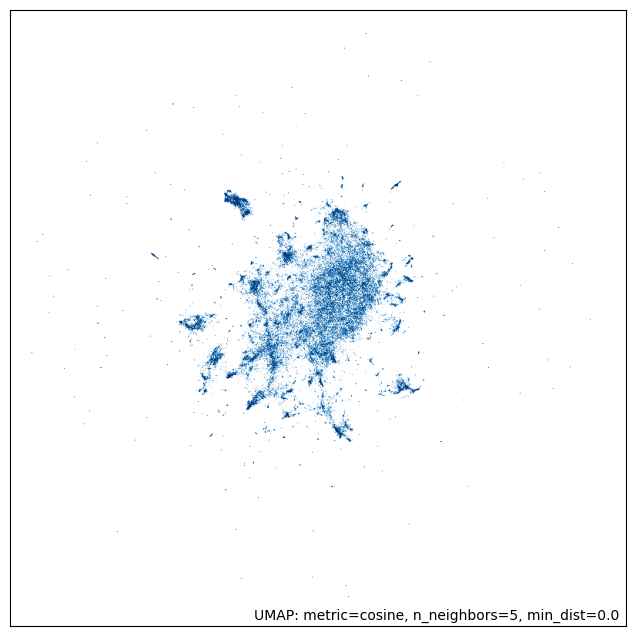

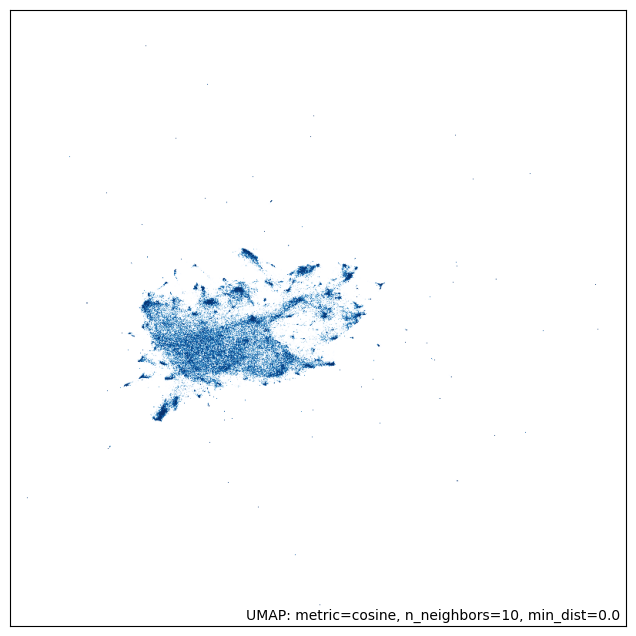

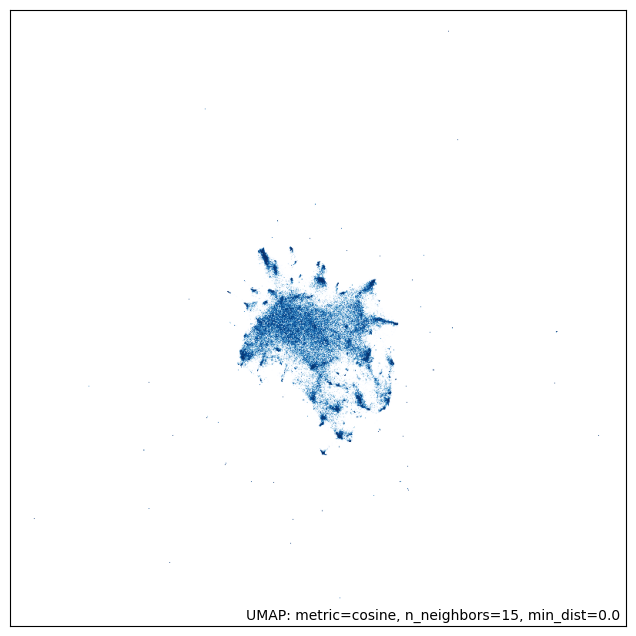

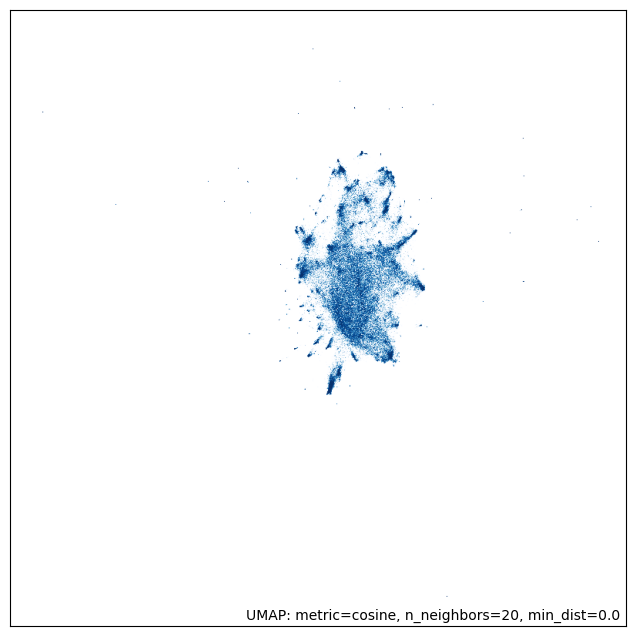

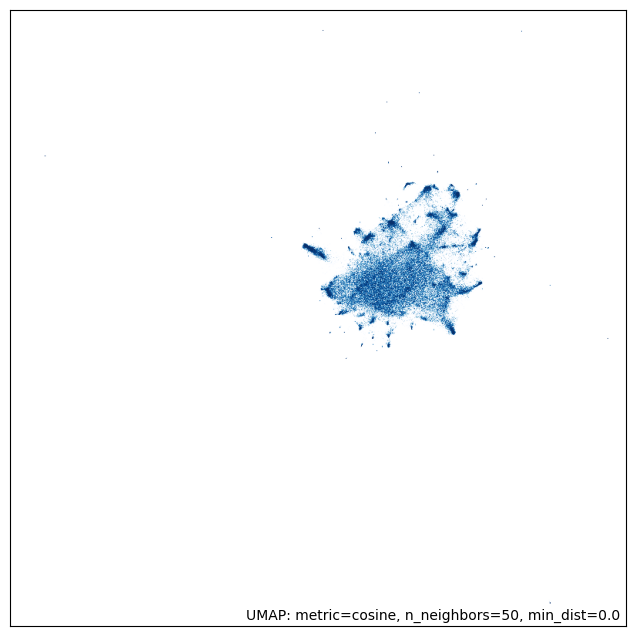

In [31]:
# sentence_transformer_model = 'snunlp/KR-SBERT-V40K-klueNLI-augSTS'

for n_neighbors in [5, 10, 15, 20, 50]:
    model = UMAP(
        n_neighbors=n_neighbors,
        min_dist=0.0,
        n_components=2,
        metric='cosine',
        random_state=42,
    )

    mapper = model.fit(embeddings)

    umap.plot.points(mapper)

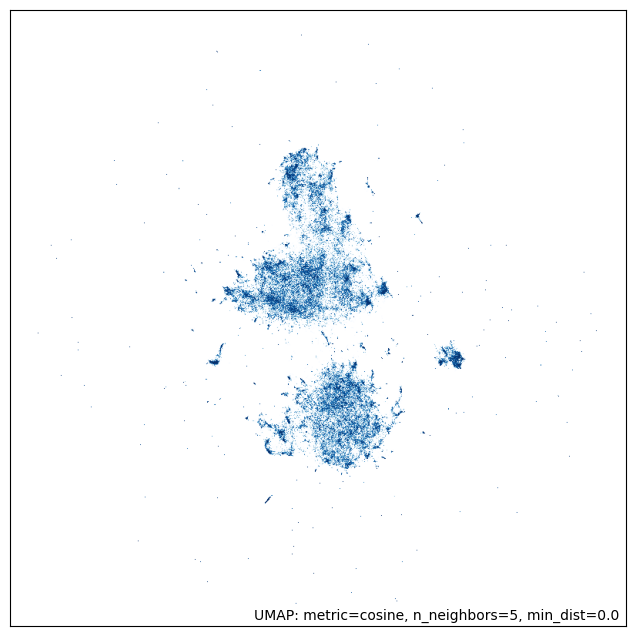

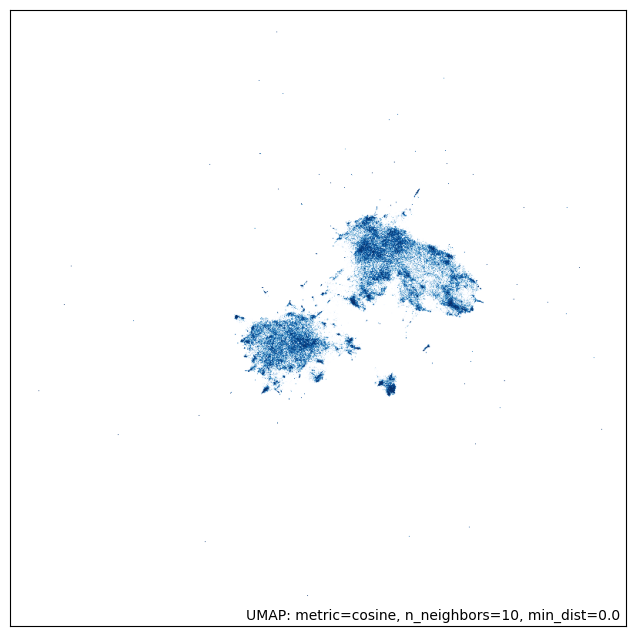

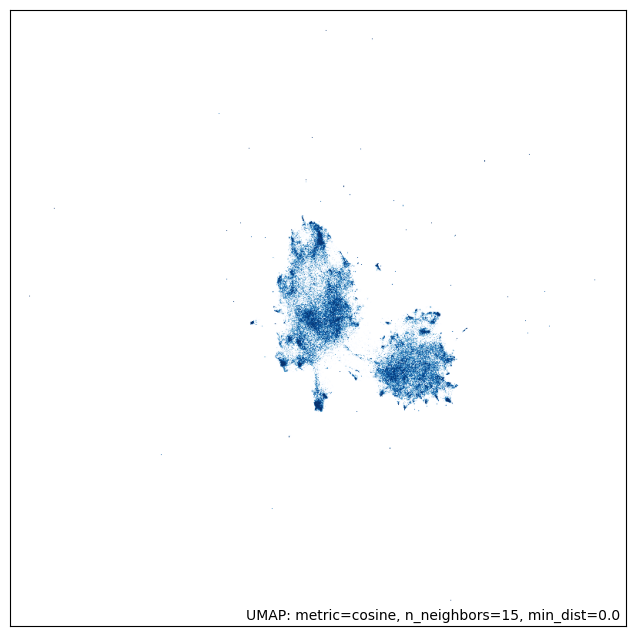

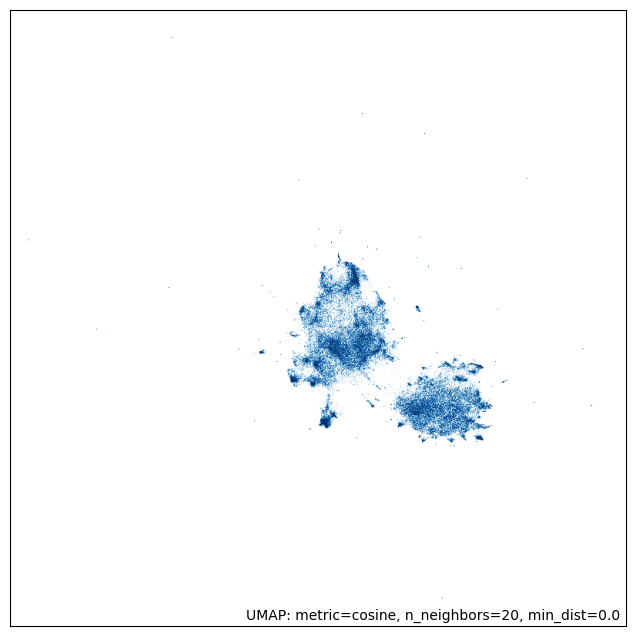

In [26]:
# sentence_transformer_model = 'paraphrase-multilingual-mpnet-base-v2'

for n_neighbors in [5, 10, 15, 20]:
    model = UMAP(
        n_neighbors=n_neighbors,
        min_dist=0.0,
        n_components=2,
        metric='cosine',
        random_state=42,
    )

    mapper = model.fit(embeddings)

    umap.plot.points(mapper)

## BERTopic

In [81]:
class KoreanTokenizer:
    """
    
    Mecab:
    https://github.com/jonghwanhyeon/python-mecab-ko
    https://www.lesbonscomptes.com/recoll/pages/recoll-korean.html
    """
    def __init__(self, tagger, stop_words):
        self.tagger = tagger
        self.stop_words = stop_words
    def __call__(self, sent):
        sent = sent[:1000000]
        word_tokens = self.tagger.morphs(sent)
        # word_tokens = self.tagger.nouns(sent)
        results = [word for word in word_tokens if len(word) > 1 and word not in self.stop_words]
        return results

In [82]:
umap_model = UMAP(
    n_neighbors=10,
    n_components=10,
    min_dist=0.0,
    metric='cosine',
    random_state=42,
)

hdbscan_model = HDBSCAN(
    min_cluster_size=300,
    min_samples=10,
    metric='euclidean',
    cluster_selection_method='eom', # 'leaf' or 'eom'
    prediction_data=True,
)

# vectorizer_model = CountVectorizer(
#     stop_words='english',
#     ngram_range=(1, 2),
# )

# https://github.com/stopwords-iso/stopwords-iso
with open(DATA_DIR / 'kr_stopwords.txt', 'r') as f:
    stop_words = f.read().splitlines()
    
stop_words += ['냐고', '다면', '다는', '지금']
    
with open(DATA_DIR / 'en_stopwords.txt', 'r') as f:
    stop_words += f.read().splitlines()

custom_tokenizer = KoreanTokenizer(
    Mecab(),
    stop_words=stop_words,
)

vectorizer_model = CountVectorizer(
    tokenizer=custom_tokenizer,
)

mmr_model = MaximalMarginalRelevance(
    diversity=0.5,
    top_n_words=20,
)

ctfidf_model = ClassTfidfTransformer(
    bm25_weighting=True,
    reduce_frequent_words=True,
)

topic_model = BERTopic(
    embedding_model=sentence_model,
    umap_model=umap_model,
    hdbscan_model=hdbscan_model,
    vectorizer_model=vectorizer_model,
    representation_model=mmr_model,
    ctfidf_model=ctfidf_model,
    top_n_words=20,
    calculate_probabilities=True,
    verbose=True,
)

In [194]:
topics, probs = topic_model.fit_transform(docs, embeddings) 

2023-05-06 10:05:06,654 - BERTopic - Reduced dimensionality
2023-05-06 10:06:00,463 - BERTopic - Clustered reduced embeddings


In [111]:
VERSION = 'v2.5'

In [87]:
topic_model.save(MODEL_DIR / f'bertopic_nuclear_{VERSION}', save_embedding_model=False)

/Users/keenansamway/miniconda3/envs/sk-nuclear/lib/python3.9/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning:

Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.



In [83]:
topic_model = BERTopic.load(MODEL_DIR / f'bertopic_nuclear_v2.5', embedding_model=sentence_model)

In [202]:
labels = [
    "-1: Outliers",
    "0: Other Topics",
    "1: Regional Security on the Korean Peninsula",
    "2: Nuclear Weapons Development and Technology", 
    "3: Ukraine, Russia, and Nuclear Weapons", 
    "4: Japan's Historical Role and Regional Relations",
    "5: China's Influence and Hegemony in East Asia", 
    "6: Iran and Middle East Relations",
    "7: Israel, Palestine, and Middle East Conflict", 
    "8: US Nuclear Umbrella and France",
    "9: Territorial Disputes and Regional Tensions", 
    "10: Existential Threats and Annihilation", 
    "11: Political Ideologies",
    "12: US Nuclear Umbrella and South Korea",
    "13: The Nuclear Non-Proliferation Treaty",
]

In [84]:
labels = [
    "-1: Outliers",
    "0: General Comments",
    "1: Regional Security",
    "6: Nuclear Technology", 
    "10: Ukraine and Russia", 
    "2: Japan",
    "3: China", 
    "11: Iran and the Middle East",
    "12: Israel and Palestine", 
    "8: US Nuclear Umbrella over France",
    "4: Territorial Disputes", 
    "7: Existential Threats", 
    "5: Political Ideologies",
    "9: US Nuclear Umbrella over South Korea",
    "13: Nuclear Non-Proliferation Treaty",
]

In [85]:
# v2.5
topic_model.set_topic_labels(labels)

topics_df = topic_model.get_topic_info()
topics_df['Keywords'] = topic_model.generate_topic_labels(nr_words=20, topic_prefix=False, separator=', ')
print(len(topics_df))
topics_df.head(20)

15


,Topic,Count,Name,CustomName,Keywords
0,-1,18307,-1_북한_한국_대한민국_중국,-1: Outliers,"북한, 한국, 대한민국, 중국, 대만, 세계, 한반도, 개발, 경제, 무기, 전쟁, 모든, 평화, 핵무기, 미군, 국가, 일본, 대통령, 해야, 생각"
1,0,54195,0_사람_감사_방송_교수,0: General Comments,"사람, 감사, 방송, 교수, 너무, 정권, 국민, 대통령, 나라, 말씀, 모르, 생각, 그냥, 뉴스, 정말, 영상, 박사, 정치, 보수, 정부"
2,1,49139,1_한국_북한_대한민국_중국,1: Regional Security,"한국, 북한, 대한민국, 중국, 무장, 문재인, 일본, 핵무기, 한반도, 박정희, 동맹, 대통령, 생각, 미국, 미사일, 해야, 개발, 경제, 코리아, 김정은"
3,2,32366,2_핵무기_무장_개발_만들,6: Nuclear Technology,"핵무기, 무장, 개발, 만들, 미사일, 해야, 잠수함, 무기, 필요, 기술, 가능, 나라, 원자력, 핵폭탄, 원전, 핵우산, 보다, 사용, 핵실험, 생각"
4,3,3977,3_우크라이나_러시아_전쟁_푸틴,10: Ukraine and Russia,"우크라이나, 러시아, 전쟁, 푸틴, 포기, 소련, 지원, 공격, 나토, 약속, 사태, 핵무기, 보장, 폴란드, 서방, 핵우산, 처럼, 무장, 해야, 나라"
5,4,3500,4_일본_아베_재무장_일본인,2: Japan,"일본, 아베, 재무장, 일본인, 독도, 한테, 식민지, 역사, 국가, 전쟁, 친일파, 협력, 아시아, 중국, 생각, 외교, 무시, 침략, 다시, 정부"
6,5,2447,5_중국_중국인_시진핑_공산당,3: China,"중국, 중국인, 시진핑, 공산당, 조선족, 추방, china, 베이징, 한족, 정권, 문화, 국가, 투표, 패권, 세계, 사람, 경제, 는데, chinese, 혜택"
7,6,1296,6_이란_석유_압수수색_사우디,11: Iran and the Middle East,"이란, 석유, 압수수색, 사우디, 관계, 중동, iran, 테헤란로, 대사관, 발언, 이슬람, 테러, 대통령, 외교, 대사, 실수, 혁명, 국가, 아랍에미리트, 정부"
8,7,877,7_팔레스타인_이란_israel_중동,12: Israel and Palestine,"팔레스타인, 이란, israel, 중동, 유대인, lebanon, 예루살렘, 아랍, hezbollah, 이슬람, 이집트, 모사드, 영국, 폭격, 이스라, 유태, 종교, 국가, 시리아, 갈등"
9,8,593,8_파리_드골_뉴욕_영국,8: US Nuclear Umbrella over France,"파리, 드골, 뉴욕, 영국, 포기, 워싱턴, 희생, 핵우산, 서울, 질문, 제재, 소련, 공격, 개발, 유럽, 그랬, 독일, 미국, 무장, 보복"


In [8]:
# regional: 1, 4, 5, 9, 11 
# nuclear: 2, 8, 10, 12
# international: 3, 6, 7, 13

regional_counts = [54195, 3500, 2447, 367, 338] # total = 60847
nuclear_counts = [32366, 593, 343, 306] # total = 33608
international_counts = [3977, 1296, 877, 305] # total = 6455

counts_total = [60847, 33608, 6455]

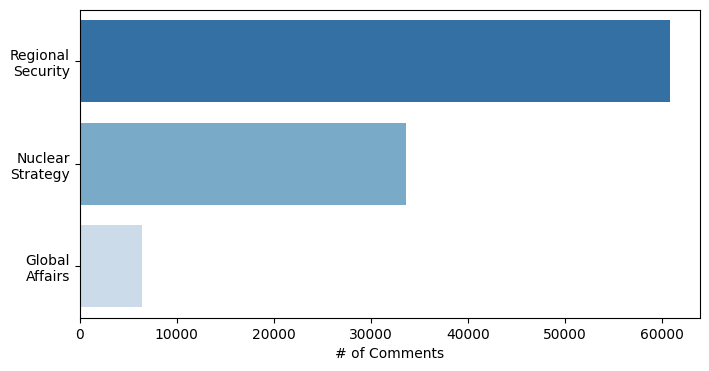

In [59]:
# plot counts_total
fig, ax = plt.subplots(figsize=(8, 4))
sns.barplot(x=counts_total, y=['Regional\nSecurity', 'Nuclear\nStrategy', 'Global\nAffairs'], ax=ax, palette='Blues_r')
ax.set_xlabel('# of Comments')
plt.show()

In [213]:
re.sub(r"@\w+", "", "@ice \n러시아가 우크라이나 침략해서 민간인 학살하는걸 일본이 극대노 할일인가 싶다")

' \n러시아가 우크라이나 침략해서 민간인 학살하는걸 일본이 극대노 할일인가 싶다'

In [127]:
topics_df[['Topic', 'Keywords']]

,Topic,Keywords
0,-1,"북한, 한국, 대한민국, 중국, 대만, 세계, 한반도, 개발, 경제, 무기, 전쟁, 모든, 평화, 핵무기, 미군, 국가, 일본, 대통령, 해야, 생각"
1,0,"사람, 감사, 방송, 교수, 너무, 정권, 국민, 대통령, 나라, 말씀, 모르, 생각, 그냥, 뉴스, 정말, 영상, 박사, 정치, 보수, 정부"
2,1,"한국, 북한, 대한민국, 중국, 무장, 문재인, 일본, 핵무기, 한반도, 박정희, 동맹, 대통령, 생각, 미국, 미사일, 해야, 개발, 경제, 코리아, 김정은"
3,2,"핵무기, 무장, 개발, 만들, 미사일, 해야, 잠수함, 무기, 필요, 기술, 가능, 나라, 원자력, 핵폭탄, 원전, 핵우산, 보다, 사용, 핵실험, 생각"
4,3,"우크라이나, 러시아, 전쟁, 푸틴, 포기, 소련, 지원, 공격, 나토, 약속, 사태, 핵무기, 보장, 폴란드, 서방, 핵우산, 처럼, 무장, 해야, 나라"
5,4,"일본, 아베, 재무장, 일본인, 독도, 한테, 식민지, 역사, 국가, 전쟁, 친일파, 협력, 아시아, 중국, 생각, 외교, 무시, 침략, 다시, 정부"
6,5,"중국, 중국인, 시진핑, 공산당, 조선족, 추방, china, 베이징, 한족, 정권, 문화, 국가, 투표, 패권, 세계, 사람, 경제, 는데, chinese, 혜택"
7,6,"이란, 석유, 압수수색, 사우디, 관계, 중동, iran, 테헤란로, 대사관, 발언, 이슬람, 테러, 대통령, 외교, 대사, 실수, 혁명, 국가, 아랍에미리트, 정부"
8,7,"팔레스타인, 이란, israel, 중동, 유대인, lebanon, 예루살렘, 아랍, hezbollah, 이슬람, 이집트, 모사드, 영국, 폭격, 이스라, 유태, 종교, 국가, 시리아, 갈등"
9,8,"파리, 드골, 뉴욕, 영국, 포기, 워싱턴, 희생, 핵우산, 서울, 질문, 제재, 소련, 공격, 개발, 유럽, 그랬, 독일, 미국, 무장, 보복"


In [48]:
topic_model.get_representative_docs(2)

['원래 우파와 좌파는 프랑스 대혁명 당시에 왕과 귀족들이 다스리던 프랑스를 국민이 주인이 되는 나라로 바꾸기 위한 과정에서 왕정을 없애고 민주주의를 도입하는 것에는 찬성했지만 그 방법에 있어서는 서로 의견이 다른 사람들이 우리의 국회와 같은 제도를 만들어서 다투다가 서로 의견이 다르니까 오른쪽과 왼쪽으로 나눠 앉은 것에서 나옵니다. 그러니까 예를 들자면 한쪽은 온건한 편이라 그냥 왕을 감옥에 가두거나 내쫓기만 하자라고 했고 다른쪽은 아니다. 그러면 안된다. 그냥 모가지를 싹둑 잘라버리자라고 하면서 싸운거죠. 그러던 것이 우리나라로 들어와서는 변질이 되는데 우리나라가 일제로부터 해방이 되고 북한에는 소련이 들어와서 통치를 하고 우리나라에는 미군이 들어와서 통치를 했는데 알다시피 소련은 공산주의 게열이라 공산국가를 건설하려했고 미국은 민주국가를 건설하려 했죠. 그 과정에서 이승만이 초대 대통령이 되었는데 이승만보다 이름높은 독립운동가들이 많아서 이승만은 그들을 제거하고 자기가 정권을 잡을 목적으로 친일파들을 기용합니다. 친일파들은 이승만에게 협조해야 목숨도 구하고 재산도 지킬 수 있으므로 이승만 편에 붙었고 미군정도 경찰이나 군인들이 죄다 일본군이나 일본경찰 출신이고 공무원들도 마찬가지였으므로 행정편의를 위해서라도 국내의 친일매국노들을 굳이 없애야 한다 생각하지 않았고요. 그런데 이 친일매국노들이 이승만에 의해 목숨을 부지하게 되자 자신들의 매국행위를 비난하는 사람들을 빨갱이로 몰아가기 시작했고 그 이후로 들어선 독재정권들도 자신들의 독재에 항거하는 국민들은 모조리 빨갱이로 몰아서 잡아죽이고 감옥에 집어넣고 고문을 했죠. 그게 우리나라 우파의 역사이고 민주주의는 개나 줘버리라면서 독재를 옹호하고 자신들과 입장이 다르면 무조건 빨갱이로 몰아가는 자들이 바로 극우이며 일베도 이런 극우집단에 속한다고 볼수가 있습니다. 일베에서 반대를 표현할때에 민주화라는 단어를 쓰는데 민주주의 국가에서 민주화라는 단어를 부정적으로 사용한다는 것부터가 이들이 극우임을 증명하는 거죠. 

In [113]:
re_list = {}
for random_state in range(17, 18):
    re_list[random_state] = UMAP(n_neighbors=10, n_components=2, min_dist=0.0, metric='cosine', random_state=random_state).fit_transform(embeddings)

In [114]:
random_state = 17
docs_fig = topic_model.visualize_documents(docs, reduced_embeddings=re_list[random_state], width=1800, height=1000, custom_labels=True, title="") # , topics=range(50)
docs_fig.show()

In [115]:
docs_fig.write_html(DATA_DIR / f'visualized-docs_{VERSION}_{random_state}.html')

In [110]:
topic_model.visualize_hierarchy(width=1800, height=1000)

In [333]:
len(nuclear_comments['published_at'].dt.date.unique().tolist())

2762

In [173]:
# timestamps = pd.date_range(start='2015-01-01', end='2023-03-01', freq='3MS').tolist()
timestamps = nuclear_comments.published_at.tolist()

In [174]:
topics_over_time = topic_model.topics_over_time(docs, timestamps, nr_bins=33)

33it [01:48,  3.29s/it]


In [175]:
time_fig = topic_model.visualize_topics_over_time(topics_over_time, width=1800, height=1000, normalize_frequency=True)
time_fig.show()

In [180]:
time_fig.write_html(DATA_DIR / f'visualized-time_{VERSION}-norm.html')

In [179]:
topic_model.visualize_barchart(n_words=15, width=500, height=400, top_n_topics=14)

In [177]:
model_df = topic_model.get_document_info(docs, nuclear_comments)

In [178]:
model_df.to_csv(DATA_DIR / f'model_df_{VERSION}.csv', index=False)

In [382]:
model_df.head()

,published_at,updated_at,video_id,comment_id,parent_id,is_top_level_comment,comment_text,author_display_name,author_channel_id,like_count,comment_clean,Document,Topic,Name,CustomName,Top_n_words,Probability,Representative_document
0,2022-03-11 15:16:58+00:00,2022-03-11 15:16:58+00:00,aUrdB_Awn3w,UgwoEwbD29y57EbuTut4AaABAg,NaN,True,독자개발아니면핵고유 핵우산은 소 용헚 없음,주나라,UCctlWJYESr_1n6uN5iKOvKw,0,독자개발아니면핵고유 핵우산은 소 용헚 없음,독자개발아니면핵고유 핵우산은 소 용헚 없음,2,2_핵무기_개발_미국_미사일,"핵무기, 개발, 미국, 미사일, 잠수함, 가능, 원전, 전쟁, 경제, 반대",핵무기 - 개발 - 미국 - 미사일 - 잠수함 - 가능 - 원전 - 전쟁 - 경제 ...,1.0,False
1,2022-02-01 13:05:57+00:00,2022-02-01 13:05:57+00:00,aUrdB_Awn3w,Ugz2K1TBFIyrfhK6NUB4AaABAg,NaN,True,강대강으로 치닫는 국제정치속에 결국엔 민족이민족을대적할것이며 나라와나라가대적할것이다...,권장원,UCbRLiLW77uSuV0Hf0faY_zQ,0,강대강으로 치닫는 국제정치속에 결국엔 민족이민족을대적할것이며 나라와나라가대적할것이다...,강대강으로 치닫는 국제정치속에 결국엔 민족이민족을대적할것이며 나라와나라가대적할것이다...,1,1_우리_미국_대통령_전쟁,"우리, 미국, 대통령, 전쟁, 트럼프, 국가, 영상, 정치, 뉴스, 자주국방",우리 - 미국 - 대통령 - 전쟁 - 트럼프 - 국가 - 영상 - 정치 - 뉴스 -...,1.0,False
2,2022-02-01 12:59:02+00:00,2022-02-01 12:59:02+00:00,aUrdB_Awn3w,Ugwf_wPhmhyK22irleJ4AaABAg,NaN,True,미국과한국은 킬체인이라는 군사협정이있다 그속에는 선제타격도포함되여있는것이다 한국이핵...,권장원,UCbRLiLW77uSuV0Hf0faY_zQ,0,미국과한국은 킬체인이라는 군사협정이있다 그속에는 선제타격도포함되여있는것이다 한국이핵...,미국과한국은 킬체인이라는 군사협정이있다 그속에는 선제타격도포함되여있는것이다 한국이핵...,0,0_일본_북한_우리_핵무기,"일본, 북한, 우리, 핵무기, 개발, 전쟁, 한반도, 동맹, 정부, 러시아",일본 - 북한 - 우리 - 핵무기 - 개발 - 전쟁 - 한반도 - 동맹 - 정부 -...,1.0,False
3,2022-01-30 16:42:25+00:00,2022-01-30 16:42:25+00:00,aUrdB_Awn3w,Ugx2pFa6O5aYL2AfhUR4AaABAg,NaN,True,교수님의 고견을 후보들이 경청하여 정책 토론 시 적극 활용하였으면 좋겠네요.,홍명숙,UCLOa41GlJ8ti1akMptqvxag,0,교수님의 고견을 후보들이 경청하여 정책 토론 시 적극 활용하였으면 좋겠네요.,교수님의 고견을 후보들이 경청하여 정책 토론 시 적극 활용하였으면 좋겠네요.,1,1_우리_미국_대통령_전쟁,"우리, 미국, 대통령, 전쟁, 트럼프, 국가, 영상, 정치, 뉴스, 자주국방",우리 - 미국 - 대통령 - 전쟁 - 트럼프 - 국가 - 영상 - 정치 - 뉴스 -...,1.0,False
4,2022-01-30 09:37:51+00:00,2022-01-30 09:51:08+00:00,aUrdB_Awn3w,UgweY7XkWNYF5jjdrR14AaABAg,NaN,True,"한국 독자 핵개발해야 한다 , 미국도 언젠가는 한국을 버릴수도 있다 , 한국에 미군...",HY K,UCQX4IuGLPbFxcQhIcDCgTpg,1,한국 독자 핵개발해야 한다 . 미국도 언젠가는 한국을 버릴수도 있다 . 한국에 미군...,한국 독자 핵개발해야 한다 . 미국도 언젠가는 한국을 버릴수도 있다 . 한국에 미군...,0,0_일본_북한_우리_핵무기,"일본, 북한, 우리, 핵무기, 개발, 전쟁, 한반도, 동맹, 정부, 러시아",일본 - 북한 - 우리 - 핵무기 - 개발 - 전쟁 - 한반도 - 동맹 - 정부 -...,1.0,False
